In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns
import matplotlib.dates as mdates
import plotly.express as px

In [10]:
data = pd.read_csv(r'C:\Users\Bim\Desktop\dash_app\datasets\pollution_2000_2023.csv')
data = data[data['Date'] >= '2010-01-01']
data = data[data['Date'] <= '2023-05-01']
data['Date'] = pd.to_datetime(data['Date'])

data.shape

(412154, 22)

In [11]:
data.head()

,Unnamed: 0,Date,Address,State,County,City,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,...,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI
246638,246638,2010-01-01,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.015235,0.034,10,31,...,5,18.0,3.333333,6.0,23,9.0,32.208333,48.0,18,45
246639,246639,2010-01-02,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.011882,0.025,10,23,...,3,15.0,4.083333,7.0,22,10.0,35.500000,51.0,9,48
246640,246640,2010-01-03,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.013176,0.028,10,26,...,2,16.0,3.208333,6.0,20,9.0,33.166667,55.0,19,52
246641,246641,2010-01-04,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.015765,0.036,9,33,...,8,15.0,3.791667,9.0,7,13.0,35.625000,55.0,7,52
246642,246642,2010-01-05,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.013529,0.030,10,28,...,23,15.0,5.041667,9.0,7,13.0,42.708333,60.0,9,57


In [12]:
pd.DataFrame(data['State'].unique())

,0
0,Arizona
1,Arkansas
2,California
3,Colorado
4,Connecticut
5,District Of Columbia
6,Florida
7,Georgia
8,Idaho
9,Illinois


In [13]:
Central_time_zone = ['Alabama','Arkansas','Illinois','Iowa','Kansas','Louisiana','Minnesota','Mississippi','Missouri','North Dakota','Oklahoma',
                     'South Dakota','Texas']
Alaska_time_zone = ['Alaska']
Mountain_time_zone = ['Arizona','Colorado','Idaho','Utah','Wyoming']
Pacific_time_zone = ['California','Nevada','Oregon','Washington']
Eastern_Time_Zone = ['District Of Columbia','Connecticut','Delaware','Florida',
                     'Georgia','Indiana','Kentucky','Maine','Maryland','Massachusetts',
                     'Michigan','New Hampshire','New Jersey','New Mexico','New York',
                     'North Carolina','Ohio','Pennsylvania','Rhode Island','South Carolina',
                     'Tennessee','Vermont','Virginia']
Hawaii_Aleutian_Time_Zone = ['Hawaii'] 

In [14]:
def determine_time_zone(row):
    state = row['State']
    if state in Central_time_zone:
        return 'Central Time Zone'
    elif state in Alaska_time_zone:
        return 'Alaska Time Zone'
    elif state in Mountain_time_zone:
        return 'Mountain Time Zone'
    elif state in Pacific_time_zone:
        return 'Pacific Time Zone'
    elif state in Eastern_Time_Zone:
        return 'Eastern Time Zone'
    elif state in Hawaii_Aleutian_Time_Zone:
        return 'Hawaii-Aleutian Time Zone'
    else:
        return 'Unknown Time Zone'


data['Time_zone'] = data.apply(determine_time_zone, axis=1)
data.columns

Index(['Unnamed: 0', 'Date', 'Address', 'State', 'County', 'City', 'O3 Mean',
       'O3 1st Max Value', 'O3 1st Max Hour', 'O3 AQI', 'CO Mean',
       'CO 1st Max Value', 'CO 1st Max Hour', 'CO AQI', 'SO2 Mean',
       'SO2 1st Max Value', 'SO2 1st Max Hour', 'SO2 AQI', 'NO2 Mean',
       'NO2 1st Max Value', 'NO2 1st Max Hour', 'NO2 AQI', 'Time_zone'],
      dtype='object')

In [15]:
data.to_csv('pollution_2010_2023.csv', index=False)

</h1>Task 01</h1>

In [16]:
timezone = data[data['Time_zone'] == 'Central Time Zone']

In [17]:
state_data = timezone.groupby(['State','Date']).agg(O3_Mean=pd.NamedAgg(column="O3 Mean", aggfunc="sum"),
                                                    CO_Mean=pd.NamedAgg(column="CO Mean", aggfunc="sum"),
                                                    SO2_Mean=pd.NamedAgg(column="SO2 Mean", aggfunc="sum"),
                                                    NO2_Mean=pd.NamedAgg(column="NO2 Mean", aggfunc="sum"))
state_data

O3_Mean   CO_Mean  SO2_Mean   NO2_Mean
State   Date                                               
Alabama 2013-12-01  0.014176  0.266667  0.313636  17.208333
        2013-12-02  0.008706  0.400000  0.530000  20.687500
        2013-12-03  0.008059  0.258333  0.305263  14.912500
        2013-12-04  0.011118  0.116667  0.131818   7.825000
        2013-12-05  0.011176  0.108333  0.000000   8.004762
...                      ...       ...       ...        ...
Texas   2023-04-27  0.120588  0.775001  1.504167  41.766667
        2023-04-28  0.155164  0.966667  1.423913  43.345833
        2023-04-29  0.116530  0.683334  0.951948  35.966485
        2023-04-30  0.159706  1.125001  1.734963  46.700524
        2023-05-01  0.194679  0.866667  1.311742  41.249457

[47829 rows x 4 columns]

In [18]:
state_data = state_data.reset_index()
state_data

,State,Date,O3_Mean,CO_Mean,SO2_Mean,NO2_Mean
0,Alabama,2013-12-01,0.014176,0.266667,0.313636,17.208333
1,Alabama,2013-12-02,0.008706,0.400000,0.530000,20.687500
2,Alabama,2013-12-03,0.008059,0.258333,0.305263,14.912500
3,Alabama,2013-12-04,0.011118,0.116667,0.131818,7.825000
4,Alabama,2013-12-05,0.011176,0.108333,0.000000,8.004762
...,...,...,...,...,...,...
47824,Texas,2023-04-27,0.120588,0.775001,1.504167,41.766667
47825,Texas,2023-04-28,0.155164,0.966667,1.423913,43.345833
47826,Texas,2023-04-29,0.116530,0.683334,0.951948,35.966485
47827,Texas,2023-04-30,0.159706,1.125001,1.734963,46.700524


In [20]:
def remove_outliers_iqr(df, columns, threshold=1.5):
        # Apply outlier removal to specified columns
        for column in columns:
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - threshold * IQR
            upper_bound = Q3 + threshold * IQR
            df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
        return df

columns_to_clean = ["O3_Mean",	"CO_Mean",	"SO2_Mean",	"NO2_Mean"]
state_data_aqi = remove_outliers_iqr(state_data, columns_to_clean)
state_data_aqi.shape

(34858, 6)

In [11]:
fig = px.line(state_data, x="Date", y="O3_Mean",
                  color="State",
                  title=f"Gas Values Over Time by State in {timezone}")
    
formatted_date = pd.to_datetime(state_data['Date']).dt.strftime("%B %d, %Y")
fig.update_traces(hovertext=formatted_date)

In [12]:
state_data2 = timezone.groupby(['State','City']).agg(O3_Mean=pd.NamedAgg(column="O3 Mean", aggfunc="sum"),
                                                             CO_Mean=pd.NamedAgg(column="CO Mean", aggfunc="sum"),
                                                             SO2_Mean=pd.NamedAgg(column="SO2 Mean", aggfunc="sum"),
                                                             NO2_Mean=pd.NamedAgg(column="NO2 Mean", aggfunc="sum")).reset_index()
state_data2

,State,City,O3_Mean,CO_Mean,SO2_Mean,NO2_Mean
0,Alabama,Birmingham,70.927305,641.482762,2253.788640,23410.748337
1,Arkansas,North Little Rock,282.041703,4018.106980,11425.273517,93848.807049
2,Illinois,Cicero,16.288764,192.310522,2008.417477,8948.088254
3,Illinois,East Saint Louis,81.806591,1032.798158,3539.544159,30195.755376
4,Illinois,Northbrook,44.354653,346.827513,1470.142318,14998.952498
5,Iowa,Davenport,145.051350,1050.499805,2751.348509,33490.554095
6,Iowa,Des Moines,112.148586,798.700087,187.737207,23537.631432
7,Kansas,Kansas City,105.110053,1168.695253,7059.099128,41591.332405
8,Louisiana,Baton Rouge,118.045408,969.206441,3502.531245,44873.775996
9,Minnesota,Blaine,92.683762,706.670254,1692.442461,20859.429032


In [14]:
fig2 = px.sunburst(state_data2, path=['State', 'City'],
                    color="O3_Mean",
                    color_continuous_scale='RdBu',
                    color_continuous_midpoint=np.average(state_data2['O3_Mean']))
fig2.show()

import matplotlib.pyplot as plt
import seaborn as sns

fig, ax = plt.subplots(ncols=4, nrows=3, figsize=(20, 18))
id = 6

for i in range(3):
    for j in range(4):
        sns.boxplot(data=data, y=data[data.columns[id]], ax=ax[i][j])
        id += 1

plt.show()


Task 02

In [21]:
data['State'].unique()

array(['Arizona', 'Arkansas', 'California', 'Colorado', 'Connecticut',
       'District Of Columbia', 'Florida', 'Georgia', 'Idaho', 'Illinois',
       'Indiana', 'Iowa', 'Kansas', 'Louisiana', 'Maine', 'Maryland',
       'Massachusetts', 'Nevada', 'New Hampshire', 'New York',
       'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma', 'Oregon',
       'Pennsylvania', 'South Carolina', 'Tennessee', 'Texas', 'Virginia',
       'Delaware', 'Hawaii', 'Minnesota', 'New Jersey', 'New Mexico',
       'Rhode Island', 'South Dakota', 'Utah', 'Wyoming', 'Alabama',
       'Kentucky', 'Missouri', 'Washington', 'Alaska', 'Mississippi',
       'Vermont', 'Michigan'], dtype=object)

In [22]:
state_selector = data[data['State'] == 'Arizona']

In [23]:
state_data = state_selector.groupby(['City','Date']).agg(O3_AQI=pd.NamedAgg(column="O3 AQI", aggfunc="mean"),
                                                CO_AQI=pd.NamedAgg(column="CO AQI", aggfunc="mean"),
                                                SO2_AQI=pd.NamedAgg(column="SO2 AQI", aggfunc="mean"),
                                                NO2_AQI=pd.NamedAgg(column="NO2 AQI", aggfunc="mean")).reset_index()
state_data

,City,Date,O3_AQI,CO_AQI,SO2_AQI,NO2_AQI
0,Phoenix,2010-01-01,30.5,16.0,6.0,43.0
1,Phoenix,2010-01-02,22.5,16.0,6.5,49.0
2,Phoenix,2010-01-03,25.5,16.5,6.0,47.0
3,Phoenix,2010-01-04,33.0,15.0,8.5,48.0
4,Phoenix,2010-01-05,25.0,16.0,8.0,52.0
...,...,...,...,...,...,...
9710,Tucson,2023-04-27,74.0,2.0,0.0,14.0
9711,Tucson,2023-04-28,58.0,2.0,0.0,12.0
9712,Tucson,2023-04-29,54.0,2.0,0.0,11.0
9713,Tucson,2023-04-30,54.0,2.0,0.0,12.0


In [24]:
columns_to_clean = ["O3_AQI", "CO_AQI", "SO2_AQI", "NO2_AQI"]
state_data = remove_outliers_iqr(state_data, columns_to_clean)
state_data.shape

(8236, 6)

In [25]:
import plotly.express as px

fig = px.scatter(state_data, x="O3_AQI", y="SO2_AQI", color="City")
fig.show()

In [19]:
len(data['State'].unique())

47

In [20]:
state_data2 = data[data['State'] == 'Alabama']
state_data2.shape

(2635, 23)

In [21]:
alabama_data = state_data2.groupby('Date').agg(O3_Mean=pd.NamedAgg(column="O3 Mean", aggfunc="sum"),
                                      CO_Mean=pd.NamedAgg(column="CO Mean", aggfunc="sum"),
                                      SO2_Mean=pd.NamedAgg(column="SO2 Mean", aggfunc="sum"),
                                      NO2_Mean=pd.NamedAgg(column="NO2 Mean", aggfunc="sum"))
alabama_data

,O3_Mean,CO_Mean,SO2_Mean,NO2_Mean
Date,,,,
2013-12-01,0.014176,0.266667,0.313636,17.208333
2013-12-02,0.008706,0.400000,0.530000,20.687500
2013-12-03,0.008059,0.258333,0.305263,14.912500
2013-12-04,0.011118,0.116667,0.131818,7.825000
2013-12-05,0.011176,0.108333,0.000000,8.004762
...,...,...,...,...
2023-04-27,0.024824,0.200000,0.640909,5.890909
2023-04-28,0.028412,0.182353,0.695000,5.580000
2023-04-29,0.034353,0.241667,0.712500,7.616667


fig, ax = plt.subplots(ncols=2,figsize = (20,8))

id = 0

for i in range(2):
    ax[i].plot(albama_data[albama_data.columns[id]])
    id += 1

plt.show()

In [22]:
data.columns

Index(['Unnamed: 0', 'Date', 'Address', 'State', 'County', 'City', 'O3 Mean',
       'O3 1st Max Value', 'O3 1st Max Hour', 'O3 AQI', 'CO Mean',
       'CO 1st Max Value', 'CO 1st Max Hour', 'CO AQI', 'SO2 Mean',
       'SO2 1st Max Value', 'SO2 1st Max Hour', 'SO2 AQI', 'NO2 Mean',
       'NO2 1st Max Value', 'NO2 1st Max Hour', 'NO2 AQI', 'Time_zone'],
      dtype='object')

In [23]:
state_data = data.groupby(['State']).agg(O3_Mean=pd.NamedAgg(column="O3 Mean", aggfunc="sum"),
                                             O3_1st_Max_Hour=pd.NamedAgg(column="O3 1st Max Hour", aggfunc="mean")).reset_index()
state_data

,State,O3_Mean,O3_1st_Max_Hour
0,Alabama,70.927305,10.036053
1,Alaska,23.165859,11.616095
2,Arizona,424.341026,10.380855
3,Arkansas,282.041703,10.598802
4,California,3153.396537,10.584186
5,Colorado,347.067774,10.577486
6,Connecticut,253.151435,11.388648
7,Delaware,77.027373,10.848171
8,District Of Columbia,198.905706,10.954559
9,Florida,129.301271,10.120134


In [24]:
# Assuming you have a dictionary with state areas in square kilometers
state_areas = {
    'Alabama': 52420,
    'Alaska': 1723337,
    'Arizona': 113594,
    'Arkansas': 137732,
    'California': 423967,
    'Colorado': 269601,
    'Connecticut': 14357,
    'Delaware': 6446,
    'District Of Columbia': 177,
    'Florida': 170312,
    'Georgia': 153910,
    'Hawaii': 2819,
    'Idaho': 216443,
    'Illinois': 149995,
    'Indiana': 94327,
    'Iowa': 145746,
    'Kansas': 213100,
    'Kentucky': 104656,
    'Louisiana': 135658,
    'Maine': 91633,
    'Maryland': 32132,
    'Massachusetts': 27336,
    'Michigan': 250487,
    'Minnesota': 225163,
    'Mississippi': 125438,
    'Missouri': 180540,
    'Nevada': 286380,
    'New Hampshire': 24214,
    'New Jersey': 22592,
    'New Mexico': 314917,
    'New York': 141297,
    'North Carolina': 139390,
    'North Dakota': 183108,
    'Ohio': 116098,
    'Oklahoma': 181037,
    'Oregon': 254800,
    'Pennsylvania': 119280,
    'Rhode Island': 4001,
    'South Carolina': 82933,
    'South Dakota': 199729,
    'Tennessee': 109153,
    'Texas': 695662,
    'Utah': 219882,
    'Vermont': 24906,
    'Virginia': 110787,
    'Washington': 184661,
    'Wyoming': 253600
}


for index, row in state_data.iterrows():
    state = row['State']
    
    # Check if the state is in the dictionary
    if state in state_areas:
        # Update the 'Area' column with the corresponding area value
        state_data.at[index, 'Area'] = state_areas[state]

# Print the modified DataFrame
print(state_data)


                   State      O3_Mean  O3_1st_Max_Hour       Area
0                Alabama    70.927305        10.036053    52420.0
1                 Alaska    23.165859        11.616095  1723337.0
2                Arizona   424.341026        10.380855   113594.0
3               Arkansas   282.041703        10.598802   137732.0
4             California  3153.396537        10.584186   423967.0
5               Colorado   347.067774        10.577486   269601.0
6            Connecticut   253.151435        11.388648    14357.0
7               Delaware    77.027373        10.848171     6446.0
8   District Of Columbia   198.905706        10.954559      177.0
9                Florida   129.301271        10.120134   170312.0
10               Georgia    99.096579        10.641002   153910.0
11                Hawaii   319.238850        10.080037     2819.0
12                 Idaho    53.539032        11.220209   216443.0
13              Illinois   142.450008        10.610014   149995.0
14        

In [25]:
state_data['O3_to_area_ratio'] = state_data['O3_Mean'] / state_data['Area']
state_data = state_data.drop('Gas_to_area_ratio',axis=1)

KeyError: "['Gas_to_area_ratio'] not found in axis"

In [ ]:
fig = px.scatter(state_data, x="O3_Mean", y="O3_1st_Max_Hour", color="State")
fig.show()

Columns 'X' and 'Y' not found in the DataFrame.


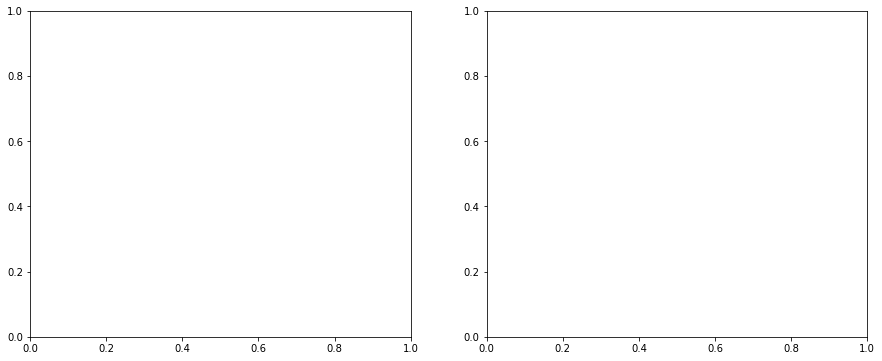

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, ax = plt.subplots(ncols=2, figsize=(15, 6))

# Assuming your dataset has two columns 'X' and 'Y' for demonstration purposes
# Replace 'X' and 'Y' with your actual column names
x_column = 'X'
y_column = 'Y'

# Check if the columns exist in the DataFrame
if x_column in alabama_data.columns and y_column in alabama_data.columns:
    for i in range(2):
        sns.scatterplot(data=alabama_data, x=alabama_data[x_column], y=alabama_data[y_column], ax=ax[i])
        # You can add more customization if needed

    plt.show()
else:
    print(f"Columns '{x_column}' and '{y_column}' not found in the DataFrame.")


In [ ]:

plt.show()


c:\Users\CHAMA COMPUTERS\Contacts\ana\lib\site-packages\numpy\lib\nanfunctions.py:1560: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a,
c:\Users\CHAMA COMPUTERS\Contacts\ana\lib\site-packages\numpy\lib\nanfunctions.py:1560: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a,
c:\Users\CHAMA COMPUTERS\Contacts\ana\lib\site-packages\numpy\lib\nanfunctions.py:1560: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a,
c:\Users\CHAMA COMPUTERS\Contacts\ana\lib\site-packages\numpy\lib\nanfunctions.py:1560: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a,
c:\Users\CHAMA COMPUTERS\Contacts\ana\lib\site-packages\numpy\lib\nanfunctions.py:1560: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a,
c:\Users\CHAMA COMPUTERS\Contacts\ana\lib\site-packages\numpy\lib\nanfunctions.py:1560: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a,
c:\Users\C

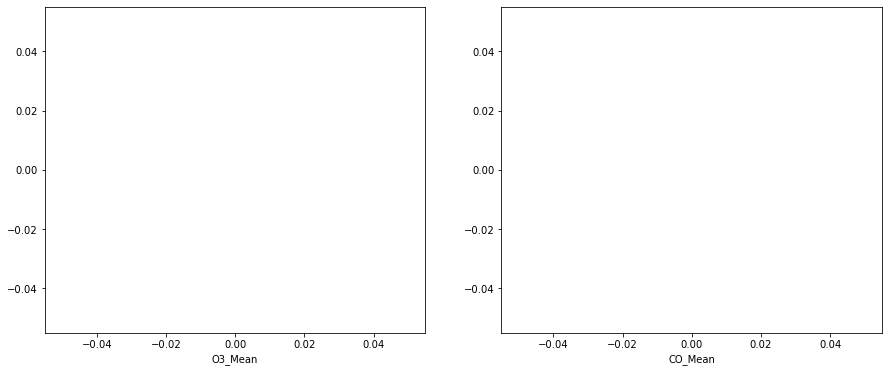

In [ ]:
fig, ax = plt.subplots(ncols=2,figsize = (15,6))

id = 0

for i in range(2):
    sns.lineplot(albama_data[albama_data.columns[id]],ax=ax[i])
    id += 1

plt.show()


albama_data.columns

In [ ]:
data.columns

Index(['Unnamed: 0', 'Date', 'Address', 'State', 'County', 'City', 'O3 Mean',
       'O3 1st Max Value', 'O3 1st Max Hour', 'O3 AQI', 'CO Mean',
       'CO 1st Max Value', 'CO 1st Max Hour', 'CO AQI', 'SO2 Mean',
       'SO2 1st Max Value', 'SO2 1st Max Hour', 'SO2 AQI', 'NO2 Mean',
       'NO2 1st Max Value', 'NO2 1st Max Hour', 'NO2 AQI'],
      dtype='object')

In [ ]:
filter_data = data[:10000]
filter_data.head()

,Unnamed: 0,Date,Address,State,County,City,O3 Mean,O3 1st Max Value,O3 1st Max Hour,O3 AQI,...,CO 1st Max Hour,CO AQI,SO2 Mean,SO2 1st Max Value,SO2 1st Max Hour,SO2 AQI,NO2 Mean,NO2 1st Max Value,NO2 1st Max Hour,NO2 AQI
0,0,2000-01-01,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.019765,0.040,10,37,...,23,25.0,3.000000,9.0,21,13.0,19.041667,49.0,19,46
1,1,2000-01-02,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.015882,0.032,10,30,...,0,26.0,1.958333,3.0,22,4.0,22.958333,36.0,19,34
2,2,2000-01-03,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.009353,0.016,9,15,...,8,28.0,5.250000,11.0,19,16.0,38.125000,51.0,8,48
3,3,2000-01-04,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.015882,0.033,9,31,...,23,34.0,7.083333,16.0,8,23.0,40.260870,74.0,8,72
4,4,2000-01-05,1645 E ROOSEVELT ST-CENTRAL PHOENIX STN,Arizona,Maricopa,Phoenix,0.007353,0.012,9,11,...,2,42.0,8.708333,15.0,7,21.0,48.450000,61.0,22,58


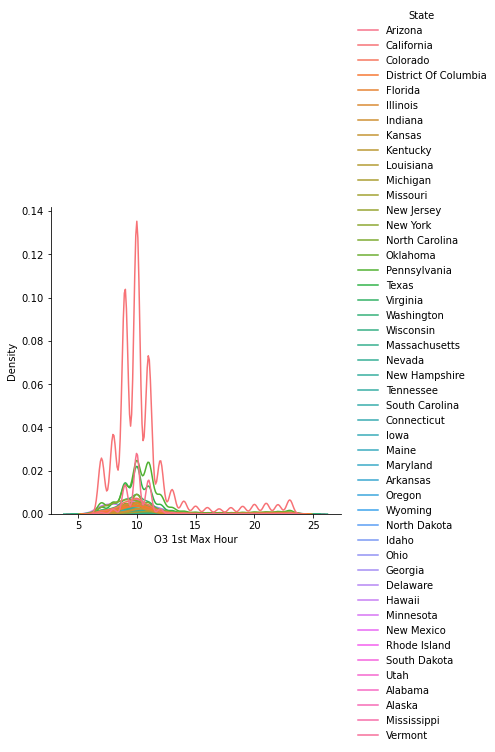

In [ ]:
sns.displot(data,x='O3 1st Max Hour',hue='State',kind='kde')

In [ ]:
sns.countplot(data,x='State')

c:\Users\CHAMA COMPUTERS\Contacts\ana\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [ ]:
data['State'].value_counts()

State
California              201244
Pennsylvania             54142
Texas                    38980
Arizona                  25118
New York                 22685
Virginia                 20571
Colorado                 16198
North Carolina           14449
Illinois                 13803
Ohio                     13376
Maryland                 13086
Hawaii                   12904
Utah                     12104
Oklahoma                 11919
New Jersey               11762
Arkansas                 11277
District Of Columbia     10517
Connecticut              10255
Iowa                     10063
Kansas                    9686
Missouri                  9653
Maine                     9378
Florida                   8738
Louisiana                 8390
Massachusetts             7581
Nevada                    7109
Kentucky                  6212
Indiana                   5855
Wyoming                   5574
Oregon                    5300
Rhode Island              5194
North Dakota              5194
Ne

In [ ]:
data.columns

Index(['Unnamed: 0', 'Date', 'Address', 'State', 'County', 'City', 'O3 Mean',
       'O3 1st Max Value', 'O3 1st Max Hour', 'O3 AQI', 'CO Mean',
       'CO 1st Max Value', 'CO 1st Max Hour', 'CO AQI', 'SO2 Mean',
       'SO2 1st Max Value', 'SO2 1st Max Hour', 'SO2 AQI', 'NO2 Mean',
       'NO2 1st Max Value', 'NO2 1st Max Hour', 'NO2 AQI'],
      dtype='object')

In [ ]:
data['State'].unique()

array(['Arizona', 'California', 'Colorado', 'District Of Columbia',
       'Florida', 'Illinois', 'Indiana', 'Kansas', 'Kentucky',
       'Louisiana', 'Michigan', 'Missouri', 'New Jersey', 'New York',
       'North Carolina', 'Oklahoma', 'Pennsylvania', 'Texas', 'Virginia',
       'Washington', 'Wisconsin', 'Massachusetts', 'Nevada',
       'New Hampshire', 'Tennessee', 'South Carolina', 'Connecticut',
       'Iowa', 'Maine', 'Maryland', 'Arkansas', 'Oregon', 'Wyoming',
       'North Dakota', 'Idaho', 'Ohio', 'Georgia', 'Delaware', 'Hawaii',
       'Minnesota', 'New Mexico', 'Rhode Island', 'South Dakota', 'Utah',
       'Alabama', 'Alaska', 'Mississippi', 'Vermont'], dtype=object)

In [ ]:
cal_data = data[data['State'] == 'Arizona']
a = sns.displot(cal_data,x='O3 1st Max Hour',hue='City',kind='kde',fill = 'True')
plt.show(a)

NameError: name 'data' is not defined

In [27]:
import plotly.figure_factory as ff

cal_data = data[data['State'] == 'Pennsylvania']
data = []
labels = []

grouped = cal_data.groupby('City')

for city, group in grouped:
    data.append(group['O3 1st Max Hour'].values)
    labels.append(city)

fig4 = ff.create_distplot(data, labels, bin_size=.2, show_rug=False)
fig4.show()

In [28]:
grouped